# Setup

## Imports

In [ ]:
import os
import re
import sys
import glob
import json
import random
import sklearn
import warnings
import itertools
import numpy as np
import pandas as pd
from tqdm import tqdm
from pathlib import Path
import matplotlib as mpl
from tensorboard import notebook
import tensorflow as tf, re, math
from tensorflow.keras import layers
from datetime import datetime, date
import matplotlib.pyplot as plt, cv2
from IPython.display import clear_output 
from tensorflow.keras import backend as K
from sklearn.metrics import roc_curve, auc
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from sklearn.model_selection import train_test_split
from tensorflow.keras.applications import ResNet101V2
from sklearn.metrics import precision_recall_curve, confusion_matrix
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, TensorBoard, LearningRateScheduler

## MISC

In [ ]:
SEED = 1
DIM = 768
EPOCHS = 50
BATCH_SIZE = 16
NUM_CLASSES = 1
VERBOSE_LEVEL = 1
SAVE_OUTPUT = True
BASE_PATH = "/content/data"

# suppress tf logs and warnings
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"
warnings.filterwarnings('ignore')
tf.get_logger().setLevel('ERROR')
tf.autograph.set_verbosity(VERBOSE_LEVEL)

# seed everything
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

# plot settings
mpl.rcParams['figure.figsize'] = (10, 10)

In [ ]:
# environment settings
print("Tensorflow version " + tf.__version__)
AUTOTUNE = tf.data.AUTOTUNE

# Tensorflow execution optimizations
# Source: https://www.tensorflow.org/guide/mixed_precision & https://www.tensorflow.org/xla
tpu = None
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver.connect() 
except:
    pass

if tpu:
    print("Try connecting to a tpu")    
    try:
        print('Running on TPU ', tpu.cluster_spec().as_dict()['worker'])
        # tf.config.experimental_connect_to_cluster(tpu)
        # tf.tpu.experimental.initialize_tpu_system(tpu)
        strategy = tf.distribute.TPUStrategy(tpu)
        REPLICAS = strategy.num_replicas_in_sync
        print("REPLICAS:", REPLICAS)
    except ValueError as error:
         raise BaseException('An exception occurred: {}'.format(error))
    except BaseException as error:
        raise BaseException('An exception occurred: {}'.format(error))
else:
    num_gpus = len(
        tf.config.experimental.list_physical_devices('GPU')
    )
    print("Using default strategy for CPU and single GPU")
    print("Num GPUs Available: ", num_gpus)
    from tensorflow.keras.mixed_precision import experimental as mixed_precision
    policy = tf.keras.mixed_precision.experimental.Policy('mixed_float16')
    mixed_precision.set_policy(policy)
    print('Mixed precision enabled')
    tf.config.optimizer.set_jit(True)
    print('Accelerated Linear Algebra enabled')
    strategy = tf.distribute.get_strategy()
    REPLICAS = strategy.num_replicas_in_sync
    print("REPLICAS:", REPLICAS)

Tensorflow version 2.4.1
Try connecting to a tpu
Running on TPU  ['10.37.127.50:8470']
REPLICAS: 8


In [ ]:
## prevent colab shutdown 
%%javascript
function ConnectButton(){
    console.log("Connect pushed"); 
    document.querySelector("#top-toolbar > colab-connect-button").shadowRoot.querySelector("#connect").click() 
}

var connection = setInterval(ConnectButton, 60000);

function myStopFunction() {
    console.log("Remove interal"); 
    clearInterval(connection);
}

<IPython.core.display.Javascript object>

## Get the Data

In [ ]:
GCS_PATH = "gs://kds-708f6da9f99dc2954ff2d86790f8c49a9b54f61bb7a60770b6f84a2e"
TRAINING_FILENAMES = tf.io.gfile.glob(GCS_PATH + '/*train*.tfrec' )
VALIDATION_FILENAMES = tf.io.gfile.glob(GCS_PATH + '/*val*.tfrec' )

print("train files", len(TRAINING_FILENAMES))
print("validation files", len(VALIDATION_FILENAMES))

train files 31
validation files 8


In [ ]:
GCS_PATH = "gs://kds-afb44a8ada06e25c6cbb8928bbaa112b799d5084603718d9d33cb0a8"
TEST_FILENAMES = tf.io.gfile.glob(GCS_PATH + '/*test*.tfrec' )
print("test files", len(TEST_FILENAMES))

test files 55


## Load TF Records

In [ ]:
def count_data_items(filenames):
    n = [int(re.compile(r"-([0-9]*)\.").search(filename).group(1)) for filename in filenames]
    return np.sum(n)


def decode_image(image_data):
    image = tf.image.decode_jpeg(image_data, channels=3)    
    # explicit size needed for TPU
    image = tf.reshape(image, [DIM, DIM, 3]) 
    
    return image


def augmentation_pipeline(image, label):
    image = tf.image.random_flip_left_right(image, seed=SEED)
    image = tf.image.random_flip_up_down(image, seed=SEED)
    image = tf.image.random_hue(image, 0.1, seed=SEED)
    image = tf.image.random_saturation(image, 0, 1, seed=SEED)
    return image, label
 

def read_labeled_tfrecord(example):
    LABELED_TFREC_FORMAT = {
        "image": tf.io.FixedLenFeature([], tf.string), # tf.string means bytestring
        "target": tf.io.FixedLenFeature([], tf.int64),  # shape [] means single element
    }
    example = tf.io.parse_single_example(example, LABELED_TFREC_FORMAT)
    image = decode_image(example['image'])
    label = example['target']
    return image, label # returns a dataset of (image, label) pairs


def read_unlabeled_tfrecord(example):
    UNLABELED_TFREC_FORMAT = {
        "image": tf.io.FixedLenFeature([], tf.string),
        "image_name": tf.io.FixedLenFeature([], tf.string), 
    }
    example = tf.io.parse_single_example(example, UNLABELED_TFREC_FORMAT)
    image = decode_image(example['image'])
    label = example['image_name']
    return image, label


def load_dataset(filenames):
    # Read from TFRecords. For optimal performance, reading from multiple files at once and
    # disregarding data order. Order does not matter since we will be shuffling the data anyway.
    opt = tf.data.Options()
    opt.experimental_deterministic = False

    dataset = tf.data.Dataset.from_tensor_slices(filenames)
    dataset = dataset.with_options(opt)

    # automatically interleaves reads from multiple files
    dataset = tf.data.TFRecordDataset(filenames, num_parallel_reads=AUTOTUNE) 
    dataset = dataset.map(read_labeled_tfrecord, num_parallel_calls=AUTOTUNE)

    # returns a dataset of (image, label) pairs if labeled=True or (image, id) pairs if labeled=False
    return dataset


def load_test_dataset(filenames):
    dataset = tf.data.TFRecordDataset(filenames, num_parallel_reads=AUTOTUNE)
    dataset = dataset.map(read_unlabeled_tfrecord, num_parallel_calls=AUTOTUNE)
    return dataset


def get_training_dataset(batch_size = BATCH_SIZE, augment = True):
    dataset = load_dataset(TRAINING_FILENAMES)
    dataset = dataset.cache()
    if augment:
        dataset = dataset.map(augmentation_pipeline, num_parallel_calls=AUTOTUNE)
    dataset = dataset.repeat() # the training dataset must repeat for several epochs
    dataset = dataset.shuffle(2048)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(AUTOTUNE) # prefetch next batch while training (autotune prefetch buffer size)
    return dataset


def get_validation_dataset(batch_size = BATCH_SIZE):
    dataset = load_dataset(VALIDATION_FILENAMES)
    dataset = dataset.cache()
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(AUTOTUNE) # prefetch next batch while validation (autotune prefetch buffer size)
    return dataset


def get_test_dataset(batch_size = BATCH_SIZE):
    dataset = load_test_dataset(TEST_FILENAMES)
    dataset = dataset.cache()
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(AUTOTUNE) # prefetch next batch while test (autotune prefetch buffer size)
    return dataset

## Verify TF Records

In [ ]:
def batch_to_numpy_images_and_labels(data):
    images, labels = data
    numpy_images = images.numpy()
    numpy_labels = labels.numpy()
    #if numpy_labels.dtype == object: # binary string in this case, these are image ID strings
    #    numpy_labels = [None for _ in enumerate(numpy_images)]
    # If no labels, only image IDs, return None for labels (this is the case for test data)
    return numpy_images, numpy_labels


def title_from_label_and_target(label, correct_label):
    CLASSES = [0,1]
    if correct_label is None:
        return CLASSES[label], True
    correct = (label == correct_label)
    return "{} [{}{}{}]".format(CLASSES[label], 'OK' if correct else 'NO', u"\u2192" if not correct else '',
                                CLASSES[correct_label] if not correct else ''), correct


def display_one_image(image, title, subplot, red=False, titlesize=16):
    plt.subplot(*subplot)
    plt.axis('off')
    plt.imshow(image)
    if len(title) > 0:
        plt.title(title, fontsize=int(titlesize) if not red else int(titlesize/1.2), color='red' if red else 'black', fontdict={'verticalalignment':'center'}, pad=int(titlesize/1.5))
    return (subplot[0], subplot[1], subplot[2]+1)


def display_batch_of_images(databatch, predictions=None):
    """This will work with:
    display_batch_of_images(images)
    display_batch_of_images(images, predictions)
    display_batch_of_images((images, labels))
    display_batch_of_images((images, labels), predictions)
    """
    # data
    images, labels = batch_to_numpy_images_and_labels(databatch)
    if labels is None:
        labels = [None for _ in enumerate(images)]
        
    # auto-squaring: this will drop data that does not fit into square or square-ish rectangle
    rows = int(math.sqrt(len(images)))
    cols = len(images)//rows
        
    # size and spacing
    FIGSIZE = 13.0
    SPACING = 0.1
    subplot=(rows,cols,1)
    if rows < cols:
        plt.figure(figsize=(FIGSIZE,FIGSIZE/cols*rows))
    else:
        plt.figure(figsize=(FIGSIZE/rows*cols,FIGSIZE))
    
    # display
    for i, (image, label) in enumerate(zip(images[:rows*cols], labels[:rows*cols])):
        title = 'Benign' if label == 0 else 'Malignant'
        correct = True
        if predictions is not None:
            title, correct = title_from_label_and_target(predictions[i], label)
        dynamic_titlesize = FIGSIZE*SPACING/max(rows,cols)*40+3 # magic formula tested to work from 1x1 to 10x10 images
        subplot = display_one_image(image, title, subplot, not correct, titlesize=dynamic_titlesize)
    
    #layout
    plt.tight_layout()
    if label is None and predictions is None:
        plt.subplots_adjust(wspace=0, hspace=0)
    else:
        plt.subplots_adjust(wspace=SPACING, hspace=SPACING)
    plt.show()

# Data Validation

In [ ]:
example_dataset = get_training_dataset(augment=False)
example_dataset = example_dataset.unbatch().batch(20)
example_batch = iter(example_dataset)   
image_batch, label_batch = next(example_batch)

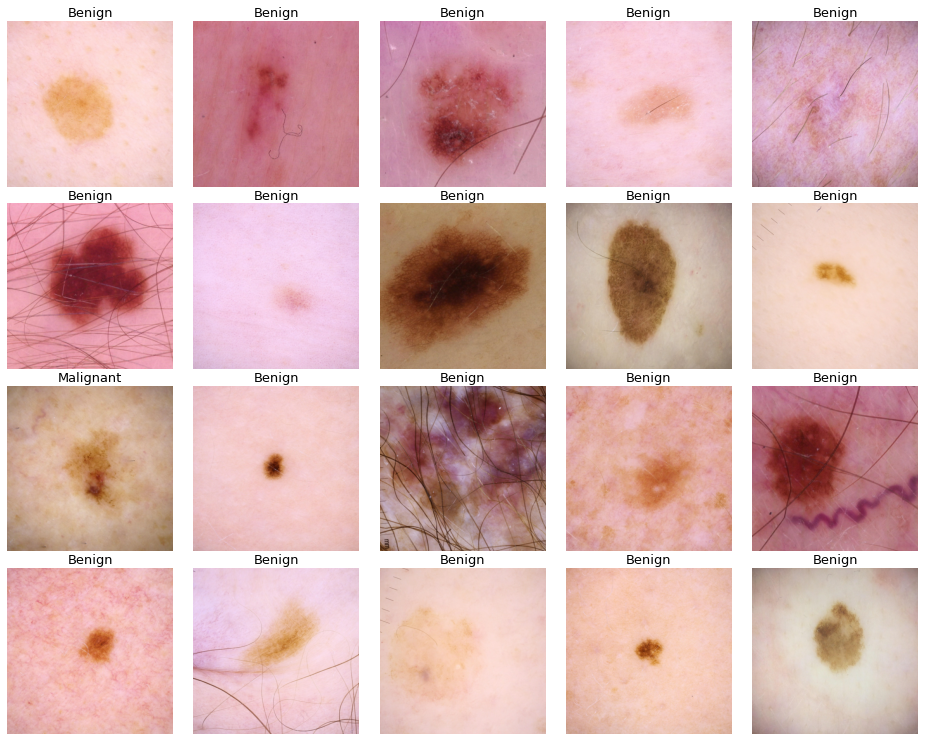

In [ ]:
display_batch_of_images((image_batch, label_batch))

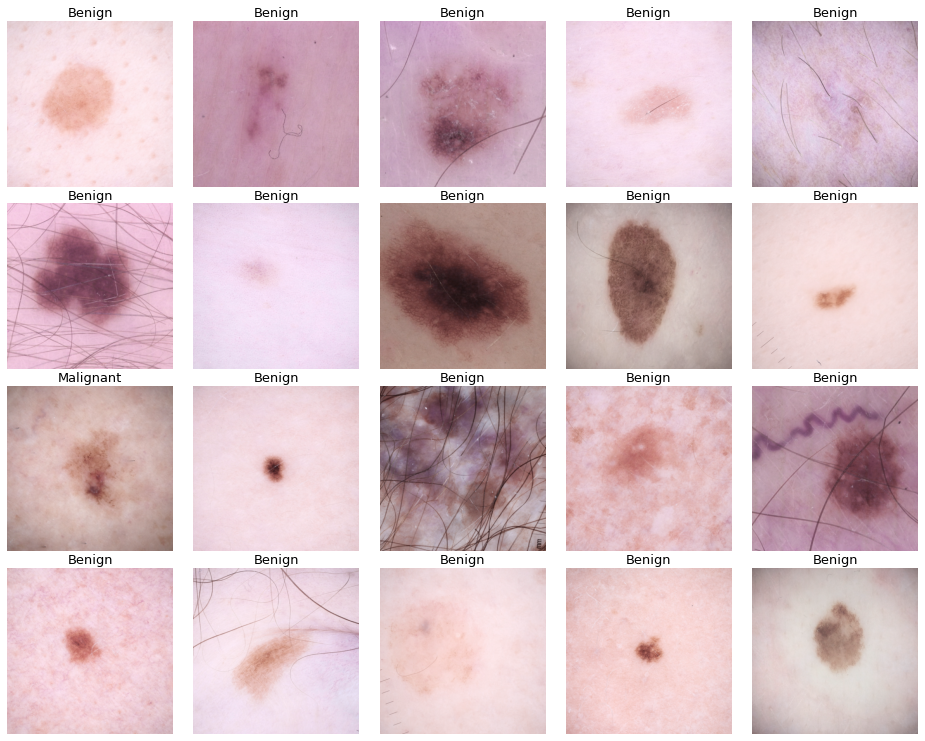

In [ ]:
image_batch, label_batch = augmentation_pipeline(image_batch, label_batch)
display_batch_of_images((image_batch, label_batch))

In [ ]:
# images are in uint8 format with values between 5 and 232
# image should be scaled between -1 and 1 => needed for resnetV2
first_image = image_batch[0]
print(np.min(first_image), np.max(first_image))
first_image.dtype

121 255


tf.uint8

In [ ]:
# Iterate over 500 batches of 20 images and labels to get the class distribution
benign_cases = 0
malignant_cases = 0

for i in range(0, 500):
    x,y = next(example_batch)
    for label in y.numpy():
        if label == 0:
            benign_cases = benign_cases + 1
        else:
            malignant_cases = malignant_cases + 1

print("benign_cases", benign_cases)
print("malignant_cases", malignant_cases)
print("ratio", round(malignant_cases / benign_cases, 2))

benign_cases 9253
malignant_cases 747
ratio 0.08


# Model

## Evaluation

In [ ]:
def plot_metrics(history):
  metrics = ['loss', 'auc', 'accuracy', 'recall']
  for n, metric in enumerate(metrics):
    name = metric.replace("_"," ").capitalize()
    plt.subplot(2,2,n+1)
    plt.plot(history.epoch, history.history[metric], label='Train')
    plt.plot(history.epoch, history.history['val_'+metric], linestyle="--", label='Val')
    plt.xlabel('Epoch')
    plt.ylabel(name)
    plt.legend()


def calc_f1(prec, recall):
    return 2*(prec*recall)/(prec+recall) if recall and prec else 0


def pred_to_binary(pred, threshold):
    if pred < threshold:
        return 0
    else:
        return 1


def plot_roc(t_y, p_y):
    fpr, tpr, thresholds = roc_curve(t_y, p_y, pos_label=1)
    fig, c_ax = plt.subplots(1, 1, figsize=(8, 8))
    c_ax.plot(fpr, tpr, label='%s (AUC:%0.2f)' % ('Target', auc(fpr, tpr)))
    c_ax.plot([0, 1], [0, 1], color='navy', lw=1, linestyle='--')
    c_ax.legend()
    c_ax.set_xlabel('False Positive Rate')
    c_ax.set_ylabel('True Positive Rate')


def plot_confusion_matrix(cm, labels, timestamp):
    plt.imshow(cm, interpolation='nearest')
    plt.title('Confusion Matrix')
    plt.colorbar()
    tick_marks = np.arange(len(labels))
    plt.xticks(tick_marks, labels, rotation=55)
    plt.yticks(tick_marks, labels)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], 'd'), horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()
    plt.savefig("./" + timestamp + "-cm.png")


def predict_on_dataset(dataset, number_of_images, is_validation = False):
    test_batch_size = 100
    steps = math.ceil(number_of_images / test_batch_size)
    dataset = dataset.unbatch().batch(test_batch_size)

    images, labels = tuple(zip(*dataset))

    label_list = []
    for i in range(steps):
        for item in labels[i].numpy().flatten():
            if is_validation:
                label_list.append(item) # read the target variable as the label
            else:
                label_list.append(item.decode("utf-8")) # read the image name as the label

    print("start predicting ...")

    dataset = dataset.map(lambda image, idnum: image)
    predictions = model.predict(dataset, steps = steps, verbose = 1)
    predictions = predictions.flatten().tolist()
    predictions = [round(num, 4) for num in predictions]

    return predictions, label_list

## Callbacks

1e-05 1.0217236263042327e-06


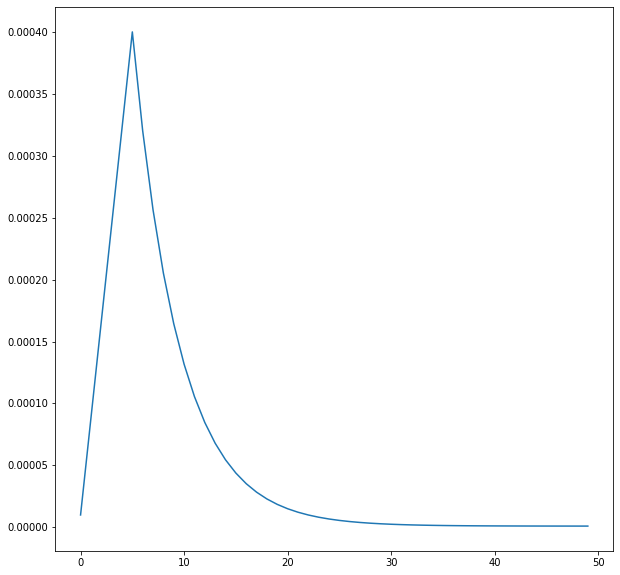

In [ ]:
# Source: https://colab.research.google.com/github/GoogleCloudPlatform/training-data-analyst/blob/master/courses/fast-and-lean-data-science/07_Keras_Flowers_TPU_xception_fine_tuned_best.ipynb#scrollTo=M-ID7vP5mIKs
# batch and learning rate settings
# TPU or 8xGPU
lr_callback = None
if strategy.num_replicas_in_sync == 8: 
    BATCH_SIZE = 128
    start_lr = 0.00001
    min_lr = 0.000001
    max_lr = 0.00005 * strategy.num_replicas_in_sync
    rampup_epochs = 5
    sustain_epochs = 0
    exp_decay = .8

    def lrfn(epoch):
        def lr(epoch, start_lr, min_lr, max_lr, rampup_epochs, sustain_epochs, exp_decay):
            if epoch < rampup_epochs:
                lr = (max_lr - start_lr)/rampup_epochs * epoch + start_lr
            elif epoch < rampup_epochs + sustain_epochs:
                lr = max_lr
            else:
                lr = (max_lr - min_lr) * exp_decay**(epoch-rampup_epochs-sustain_epochs) + min_lr
            return lr
        return lr(epoch, start_lr, min_lr, max_lr, rampup_epochs, sustain_epochs, exp_decay)
        
    lr_callback = tf.keras.callbacks.LearningRateScheduler(lambda epoch: lrfn(epoch), verbose=True)

    rng = [i for i in range(EPOCHS)]
    y = [lrfn(x) for x in rng]
    plt.plot(rng, [lrfn(x) for x in rng])
    print(y[0], y[-1])

In [ ]:
def get_model_callbacks(verbose_level, save_output, timestamp):
    # model callbacks
    callback_list = []

    if lr_callback:
        callback_list.append(lr_callback)

    # if the model does not improve for 10 epochs, stop the training
    stop_early = EarlyStopping(
        monitor='val_auc',
        mode='max',
        patience=10,
        restore_best_weights=True
    )
    callback_list.append(stop_early)

    # add tensorboard
    log_dir = "logs/fit/" + timestamp
    tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)
    if not tpu: # because we cannot use the local disk
        callback_list.append(tensorboard_callback)

    ## learning rate decay
    #lr_scheduler = tf.keras.callbacks.LearningRateScheduler(lambda epoch: lrfn(epoch), verbose=True)
    #callback_list.append(lr_scheduler)

    # if the output of the model should be saved, create a checkpoint callback function
    if save_output:
        # set the weight path for saving the model
        weight_path = "./" + timestamp + "-model.hdf5"
        # create the model checkpoint callback to save the model weights to a file
        checkpoint = ModelCheckpoint(
            weight_path,
            save_weights_only=True,
            verbose=verbose_level,
            save_best_only=True,
            monitor='val_auc',
            overwrite=True,
            mode='max',
        )
        # append the checkpoint callback to the callback list
        callback_list.append(checkpoint)

    return callback_list

## Tensorboard

In [ ]:
# Clear any logs from previous runs
!rm -rf ./logs/

# make sure we do not init Tensorboard multiple times
# if callbacks is defined, a Tensorboard was already initialized
try:
    callbacks
except:
    %load_ext tensorboard
    %tensorboard --logdir logs/fit
else:
    %reload_ext tensorboard   

Reusing TensorBoard on port 6006 (pid 319), started 2:34:50 ago. (Use '!kill 319' to kill it.)

<IPython.core.display.Javascript object>

## Model

In [ ]:
print('There are', count_data_items(TRAINING_FILENAMES) ,'train images')
print('There are', count_data_items(VALIDATION_FILENAMES) ,'val images')

training_dataset = get_training_dataset()
validation_dataset = get_validation_dataset()

There are 6073 train images
There are 1519 val images


In [ ]:
total_imgs = count_data_items(TRAINING_FILENAMES)

print("total_imgs", total_imgs)
print("benign_cases", benign_cases)
print("malignant_cases", malignant_cases)

print(" ")

bias = np.log([malignant_cases/benign_cases])
output_bias = tf.keras.initializers.Constant(bias)
print("bias", bias)

weight_for_0 = (1 / benign_cases)*(total_imgs)/2.0 
weight_for_1 = (1 / malignant_cases)*(total_imgs)/2.0

class_weight = {0: weight_for_0, 1: weight_for_1}

print('Weight for class 0: {:.2f}'.format(weight_for_0))
print('Weight for class 1: {:.2f}'.format(weight_for_1))

total_imgs 6073
benign_cases 9253
malignant_cases 747
 
bias [-2.51663792]
Weight for class 0: 0.33
Weight for class 1: 4.06


In [ ]:
# Increase the steps per epoch by MULTIPLIER if we train on a TPU
MULTIPLIER = 60 if tpu else 1

steps_per_epoch = (count_data_items(TRAINING_FILENAMES)/BATCH_SIZE//REPLICAS) * MULTIPLIER
validation_steps_per_epoch = (count_data_items(VALIDATION_FILENAMES)/BATCH_SIZE//REPLICAS) * MULTIPLIER

print("steps_per_epoch", steps_per_epoch)
print("validation_steps_per_epoch", validation_steps_per_epoch)

# get the current timestamp. This timestamp is used to save the model data with a unique name
now = datetime.now()
today = date.today()
current_time = now.strftime("%H:%M:%S")
timestamp = str(today) + "_" + str(current_time)

# get the model callbacks
callbacks = get_model_callbacks(VERBOSE_LEVEL, SAVE_OUTPUT, timestamp)

steps_per_epoch 300.0
validation_steps_per_epoch 60.0


In [ ]:
def get_model_parameters():
    loss = 'binary_crossentropy'
    metrics = [
        tf.keras.metrics.BinaryAccuracy(name='accuracy'),
        tf.keras.metrics.AUC(name='auc'),
        tf.keras.metrics.Precision(name="precision"),
        tf.keras.metrics.Recall(name="recall"),
    ]

    return loss, metrics

In [ ]:
K.clear_session()

# Creating the model in the TPUStrategy scope places the model on the TPU
with strategy.scope(): 
    loss, metrics = get_model_parameters()

    ## Create a pretrained resnet model

    # preprocessing needed for resnet
    i = tf.keras.layers.Input([DIM, DIM, 3], dtype = tf.uint8)
    x = tf.cast(i, tf.float32)
    x = tf.keras.applications.resnet_v2.preprocess_input(x)
    input_pretrained_model = tf.keras.Model(inputs=[i], outputs=[x], name="input_pretrained_model")

    # create base model
    pretrained_model = tf.keras.applications.ResNet101V2(
        weights="imagenet",  # Load weights pre-trained on ImageNet
        input_shape=(DIM, DIM, 3),
        include_top=False,
    )

    # freeze the model
    # we can't use pretrained_model.trainable = False because of an issue between the keras and tf implementation
    # https://github.com/tensorflow/tensorflow/issues/29535
    for layer in pretrained_model.layers:
        layer.trainable = False

    ## create the final model
    model = tf.keras.Sequential([
        input_pretrained_model,
        pretrained_model,
        tf.keras.layers.GlobalAveragePooling2D(),
        tf.keras.layers.Dense(1024, activation="relu"),
        tf.keras.layers.Dropout(0.3),
        tf.keras.layers.Dense(512, activation="relu"),
        tf.keras.layers.Dropout(0.3),
        tf.keras.layers.Dense(128, activation="relu"),
        tf.keras.layers.Dense(NUM_CLASSES, activation='sigmoid', bias_initializer=output_bias)
    ])

    if tpu:
        model.compile(
            loss=loss,
            metrics=metrics,
            optimizer='adam',
            # Reduce python overhead, and maximize the performance of your TPU
            # Anything between 2 and `steps_per_epoch` could help here.
            steps_per_execution = steps_per_epoch / 10,
        )
    else:
        model.compile(
            loss=loss,
            metrics=metrics,
            optimizer='adam',
        )

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_pretrained_model (Func (None, 768, 768, 3)       0         
_________________________________________________________________
resnet101v2 (Functional)     (None, 24, 24, 2048)      42626560  
_________________________________________________________________
global_average_pooling2d (Gl (None, 2048)              0         
_________________________________________________________________
dense (Dense)                (None, 1024)              2098176   
_________________________________________________________________
dropout (Dropout)            (None, 1024)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 512)               524800    
_________________________________________________________________
dropout_1 (Dropout)          (None, 512)               0

In [ ]:
history = model.fit(
    training_dataset,
    epochs=EPOCHS,
    callbacks=callbacks,
    steps_per_epoch=steps_per_epoch,
    validation_data=validation_dataset,
    validation_steps=validation_steps_per_epoch,
    verbose=VERBOSE_LEVEL
)

Epoch 1/50

Epoch 00001: LearningRateScheduler reducing learning rate to 1e-05.
300/300 [==============================] - 83s 278ms/step - loss: 0.2623 - accuracy: 0.9268 - auc: 0.6140 - precision: 0.0000e+00 - recall: 0.0000e+00 - val_loss: 0.2413 - val_accuracy: 0.9177 - val_auc: 0.8187 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00

Epoch 00001: val_auc improved from -inf to 0.81870, saving model to ./2021-03-04_09:28:07-model.hdf5
Epoch 2/50

Epoch 00002: LearningRateScheduler reducing learning rate to 8.8e-05.
300/300 [==============================] - 21s 70ms/step - loss: 0.2418 - accuracy: 0.9207 - auc: 0.7705 - precision: 0.3232 - recall: 0.0231 - val_loss: 0.2325 - val_accuracy: 0.9177 - val_auc: 0.8403 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00
Epoch 3/50

Epoch 00003: LearningRateScheduler reducing learning rate to 0.000166.
300/300 [==============================] - 21s 69ms/step - loss: 0.2300 - accuracy: 0.9149 - auc: 0.8213 - precision: 0.2841 - recall:

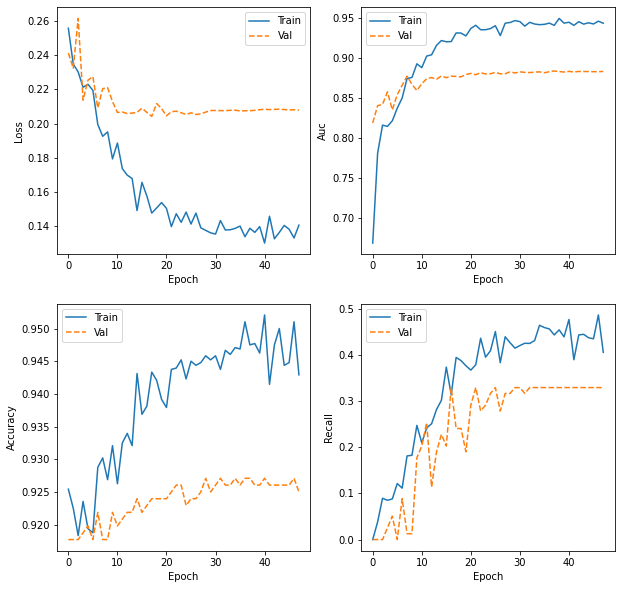

In [ ]:
plot_metrics(history)

In [ ]:
validation_images = count_data_items(VALIDATION_FILENAMES)
predictions, labels = predict_on_dataset(validation_dataset, validation_images, is_validation = True)

start predicting ...
16/16 [==============================] - 62s 4s/step


In [ ]:
y_t = labels  # true labels
y_p = predictions  # predictions

precision, recall, thresholds = precision_recall_curve(y_t, y_p)
f1score = [calc_f1(precision[i], recall[i])
               for i in range(len(thresholds))]

# get the index from the highest f1 score
idx = np.argmax(f1score)

# get the precision, recall, threshold and the f1score
precision = round(precision[idx], 4)
recall = round(recall[idx], 4)
threshold = round(thresholds[idx], 4)
f1score = round(f1score[idx], 4)

print('Precision:', precision)
print('Recall:', recall)
print('Threshold:', threshold)
print('F1 Score:', f1score)

Precision: 0.6061
Recall: 0.3419
Threshold: 0.5135
F1 Score: 0.4372


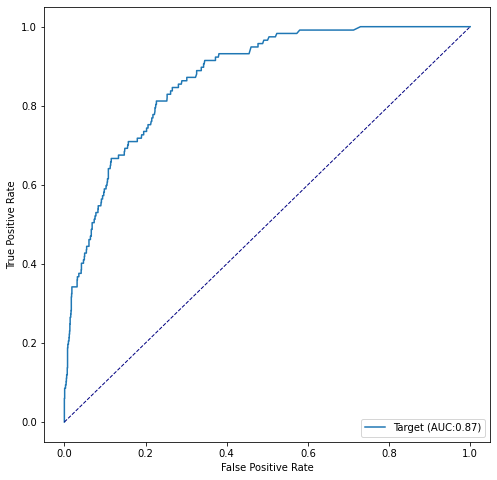

In [ ]:
plot_roc(y_t, y_p)
plt.legend(loc='lower right')

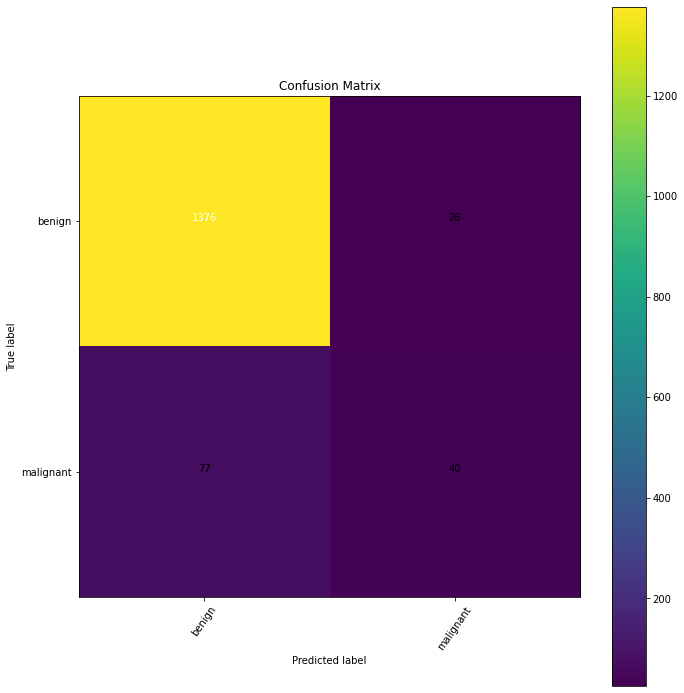

In [ ]:
y_pred_binary = [pred_to_binary(x, threshold) for x in y_p]
cm = confusion_matrix(y_t, y_pred_binary)
cm_plot_label = ['benign', 'malignant']
plot_confusion_matrix(cm, cm_plot_label, timestamp)

In [ ]:
example_validation_dataset = get_validation_dataset()
example_validation_dataset = example_validation_dataset.unbatch().batch(20)
example_validation_batch = iter(example_validation_dataset)   
validation_image_batch, validation_label_batch = next(example_validation_batch)

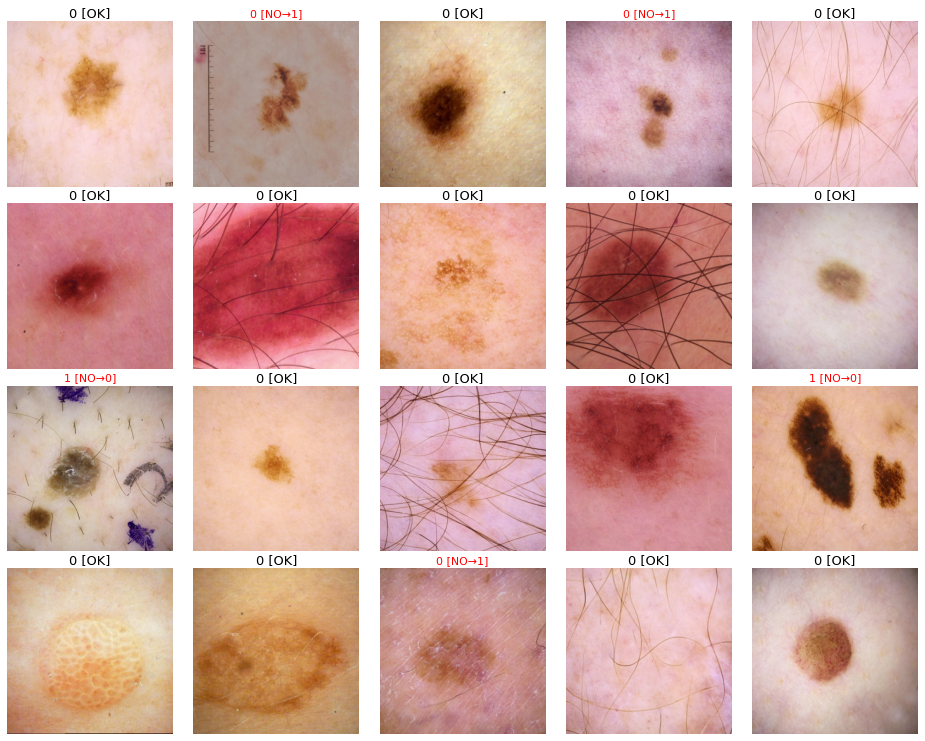

In [ ]:
predictions_mapped = [0 if x < threshold else 1 for x in predictions]
display_batch_of_images((validation_image_batch, validation_label_batch), predictions_mapped)

In [ ]:
K.clear_session()

with strategy.scope(): 
    print("conv5_block: ")
    # We unfreeze the last conv block while leaving BatchNorm layers frozen
    for layer in model.layers[1].layers:
        if not isinstance(layer, layers.BatchNormalization) and "conv5_" in layer.name:
            layer.trainable = True
        if "conv5_" in layer.name:
            print(layer.name, layer.trainable)
    print(" ")

    if tpu:
        model.compile(
            loss=loss,
            metrics=metrics,
            optimizer='adam',
            # Reduce python overhead, and maximize the performance of your TPU
            # Anything between 2 and `steps_per_epoch` could help here.
            steps_per_execution = steps_per_epoch / 10,
        )
    else:
        model.compile(
            loss=loss,
            metrics=metrics,
            optimizer='adam',
        )

model.summary()

conv5_block: 
conv5_block1_preact_bn False
conv5_block1_preact_relu True
conv5_block1_1_conv True
conv5_block1_1_bn False
conv5_block1_1_relu True
conv5_block1_2_pad True
conv5_block1_2_conv True
conv5_block1_2_bn False
conv5_block1_2_relu True
conv5_block1_0_conv True
conv5_block1_3_conv True
conv5_block1_out True
conv5_block2_preact_bn False
conv5_block2_preact_relu True
conv5_block2_1_conv True
conv5_block2_1_bn False
conv5_block2_1_relu True
conv5_block2_2_pad True
conv5_block2_2_conv True
conv5_block2_2_bn False
conv5_block2_2_relu True
conv5_block2_3_conv True
conv5_block2_out True
conv5_block3_preact_bn False
conv5_block3_preact_relu True
conv5_block3_1_conv True
conv5_block3_1_bn False
conv5_block3_1_relu True
conv5_block3_2_pad True
conv5_block3_2_conv True
conv5_block3_2_bn False
conv5_block3_2_relu True
conv5_block3_3_conv True
conv5_block3_out True
 
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Sha

In [ ]:
history = model.fit(
    training_dataset,
    epochs=EPOCHS,
    callbacks=callbacks,
    steps_per_epoch=steps_per_epoch,
    validation_data=validation_dataset,
    validation_steps=validation_steps_per_epoch,
    verbose=VERBOSE_LEVEL
)

Epoch 1/50

Epoch 00001: LearningRateScheduler reducing learning rate to 1e-05.
300/300 [==============================] - 84s 281ms/step - loss: 0.1525 - accuracy: 0.9375 - auc: 0.9082 - precision: 0.6867 - recall: 0.3543 - val_loss: 0.2059 - val_accuracy: 0.9250 - val_auc: 0.8830 - val_precision: 0.6667 - val_recall: 0.1772

Epoch 00001: val_auc did not improve from 0.88371
Epoch 2/50

Epoch 00002: LearningRateScheduler reducing learning rate to 8.8e-05.
300/300 [==============================] - 21s 70ms/step - loss: 0.2187 - accuracy: 0.9268 - auc: 0.8122 - precision: 0.5802 - recall: 0.1206 - val_loss: 0.2376 - val_accuracy: 0.9135 - val_auc: 0.8632 - val_precision: 0.1667 - val_recall: 0.0127

Epoch 00002: val_auc did not improve from 0.88371
Epoch 3/50

Epoch 00003: LearningRateScheduler reducing learning rate to 0.000166.
300/300 [==============================] - 22s 72ms/step - loss: 0.2144 - accuracy: 0.9246 - auc: 0.8320 - precision: 0.4922 - recall: 0.1093 - val_loss: 0.20

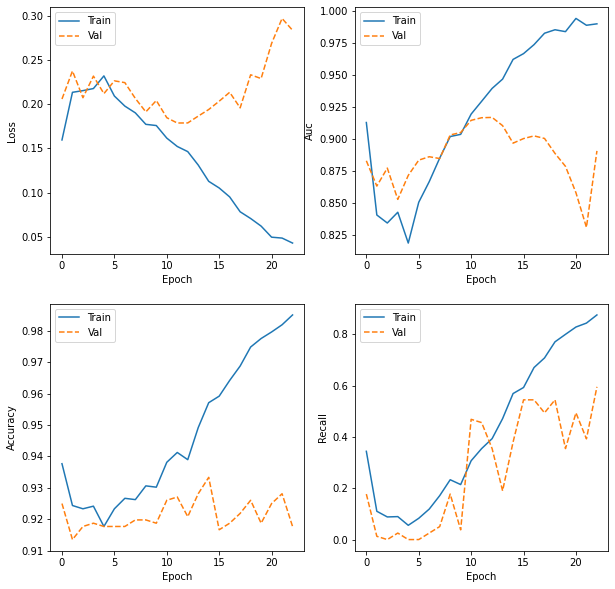

In [ ]:
plot_metrics(history)

In [ ]:
validation_images = count_data_items(VALIDATION_FILENAMES)
predictions, labels = predict_on_dataset(validation_dataset, validation_images, is_validation = True)

start predicting ...
16/16 [==============================] - 65s 4s/step


In [ ]:
y_t = labels  # true labels
y_p = predictions  # predictions

precision, recall, thresholds = precision_recall_curve(y_t, y_p)
f1score = [calc_f1(precision[i], recall[i])
               for i in range(len(thresholds))]

# get the index from the highest f1 score
idx = np.argmax(f1score)

# get the precision, recall, threshold and the f1score
precision = round(precision[idx], 4)
recall = round(recall[idx], 4)
threshold = round(thresholds[idx], 4)
f1score = round(f1score[idx], 4)

print('Precision:', precision)
print('Recall:', recall)
print('Threshold:', threshold)
print('F1 Score:', f1score)

Precision: 0.457
Recall: 0.5897
Threshold: 0.2493
F1 Score: 0.5149


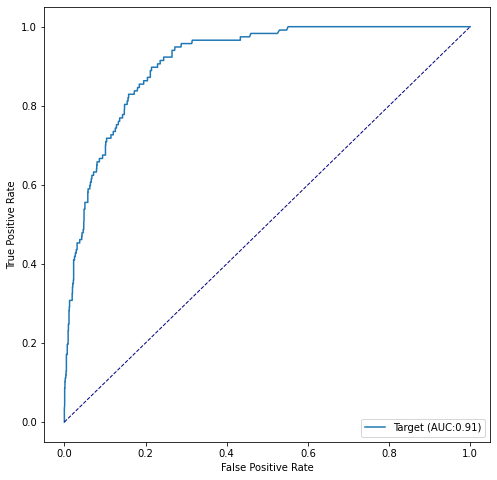

In [ ]:
plot_roc(y_t, y_p)
plt.legend(loc='lower right')

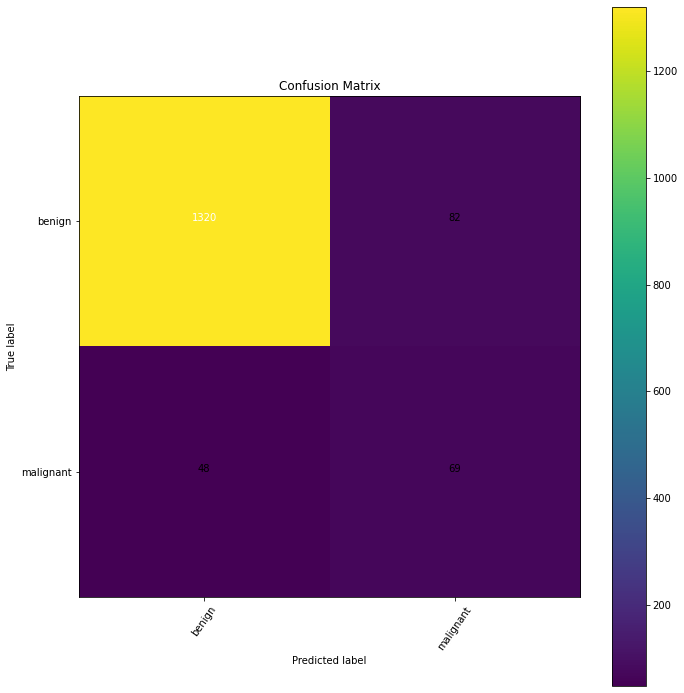

In [ ]:
y_pred_binary = [pred_to_binary(x, threshold) for x in y_p]
cm = confusion_matrix(y_t, y_pred_binary)
cm_plot_label = ['benign', 'malignant']
plot_confusion_matrix(cm, cm_plot_label, timestamp)

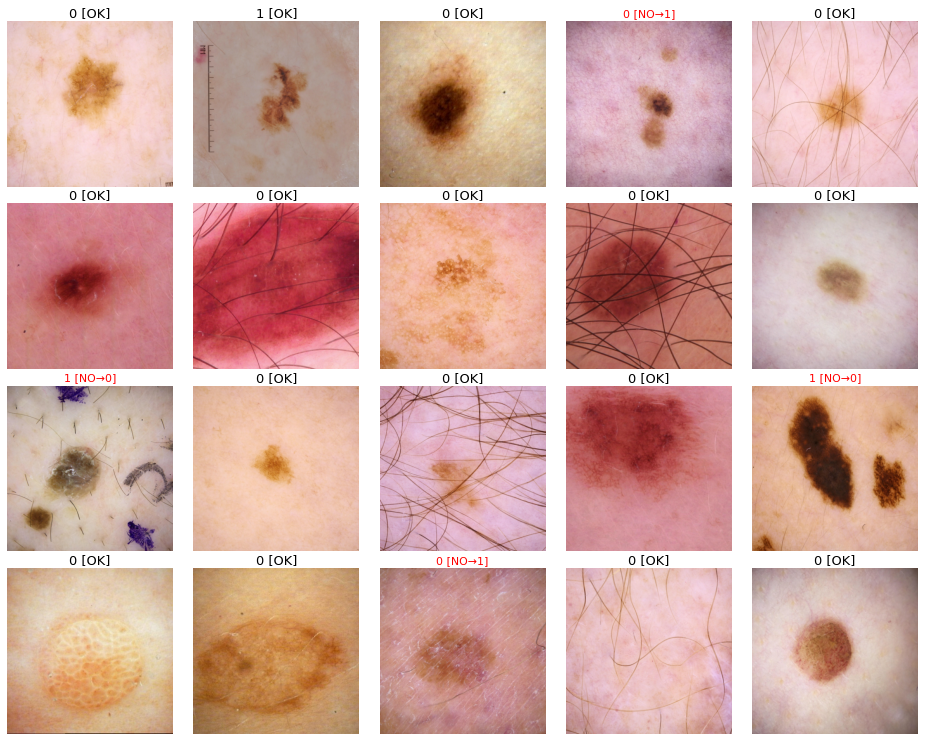

In [ ]:
predictions_mapped = [0 if x < threshold else 1 for x in predictions]
display_batch_of_images((validation_image_batch, validation_label_batch), predictions_mapped)

# Submission

In [ ]:
test_batch_size = 100
test_dataset = get_test_dataset()
test_images = count_data_items(TEST_FILENAMES)

steps = math.ceil(test_images / test_batch_size)
test_dataset = test_dataset.unbatch().batch(test_batch_size)

In [ ]:
images, labels = tuple(zip(*test_dataset))

label_list = []
for i in range(steps):
    for item in labels[i].numpy().flatten():
        label_list.append(item.decode("utf-8"))

print(label_list[:5])

['ISIC_0052060', 'ISIC_0297702', 'ISIC_0479726', 'ISIC_0641371', 'ISIC_0808861', 'ISIC_0976715', 'ISIC_1159131', 'ISIC_1351779', 'ISIC_1522983', 'ISIC_1705293', 'ISIC_1901270', 'ISIC_2083907', 'ISIC_2263660', 'ISIC_2434912', 'ISIC_2607622', 'ISIC_2804825', 'ISIC_0052349', 'ISIC_0298417', 'ISIC_0479755', 'ISIC_0644758', 'ISIC_0809377', 'ISIC_0977528', 'ISIC_1159934', 'ISIC_1352021', 'ISIC_1523725', 'ISIC_1705442', 'ISIC_1901914', 'ISIC_2085335', 'ISIC_2265045', 'ISIC_2435805', 'ISIC_2607761', 'ISIC_2806461', 'ISIC_0058510', 'ISIC_0299870', 'ISIC_0480158', 'ISIC_0644873', 'ISIC_0809747', 'ISIC_0977840', 'ISIC_1162854', 'ISIC_1352715', 'ISIC_1524188', 'ISIC_1706022', 'ISIC_1901966', 'ISIC_2085532', 'ISIC_2266450', 'ISIC_2437222', 'ISIC_2609978', 'ISIC_2806463', 'ISIC_0073313', 'ISIC_0300002', 'ISIC_0481105', 'ISIC_0645560', 'ISIC_0810336', 'ISIC_0979085', 'ISIC_1164661', 'ISIC_1354933', 'ISIC_1524620', 'ISIC_1706501', 'ISIC_1903251', 'ISIC_2086396', 'ISIC_2268765', 'ISIC_2438069', 'ISIC_2

In [ ]:
print("start predicting ...")
test_dataset = test_dataset.map(lambda image, idnum: image)
predictions = model.predict(test_dataset, steps = steps, verbose = 1)
predictions = predictions.flatten().tolist()
predictions = [round(num, 4) for num in predictions]

start predicting ...
110/110 [==============================] - 39s 353ms/step


In [ ]:
print("min", np.min(predictions))
print("max", np.max(predictions))
print(predictions[:15])

min 0.0
max 0.9957
[0.0, 0.0131, 0.001, 0.003, 0.0381, 0.0709, 0.008, 0.2245, 0.0247, 0.0648, 0.0108, 0.0001, 0.0906, 0.0053, 0.1035]


In [ ]:
# check were the kaggle auth file is stored
path_to_auth_file = "kaggle.json"
if not os.path.exists(path_to_auth_file):
    path_to_auth_file = '/content/drive/MyDrive/Colab Notebooks/_auth/kaggle.json'

# read the kaggle.json file
with open(path_to_auth_file) as json_file:
    data = json.load(json_file)
    os.environ['KAGGLE_USERNAME'] = data["username"]
    os.environ['KAGGLE_KEY'] = data["key"]

In [ ]:
if len(predictions) == len(label_list):
    sub_df = pd.DataFrame(list(zip(label_list, predictions)), columns = ['image_name', 'target']) 
    sub_df.to_csv("./submission.csv", index=False)
    print(sub_df.head())

     image_name  target
0  ISIC_0052060  0.0000
1  ISIC_0297702  0.0131
2  ISIC_0479726  0.0010
3  ISIC_0641371  0.0030
4  ISIC_0808861  0.0381


In [ ]:
if len(predictions) == len(label_list):
    !kaggle competitions submit -c siim-isic-melanoma-classification -f submission.csv -m "Sub"

100% 211k/211k [00:01<00:00, 134kB/s]
Successfully submitted to SIIM-ISIC Melanoma Classification